In [7]:
import sys
sys.path.append("/Users/phoebezhouhuixin/FRModel")

In [1]:
import os
os.getcwd()

'/Users/phoebezhouhuixin/FRModel/src'

In [6]:
from frmodel.base.D2.frame2D import Frame2D
import numpy as np
import pandas as pd
from scipy.spatial import cKDTree, KDTree
import matplotlib.pyplot as plt

In [11]:
frame = Frame2D.from_image("../rsc/imgs/chestnut_0/screenshot.png")

In [16]:
frame.data = frame.data[...,:3]

In [5]:
class Try:
    staticattr = "A"
    def __init__(self, instanceattr):
        self.instanceattr = instanceattr

tryobjb = Try("B")
tryobjc = Try("C")
tryobjb.staticattr = "B" # change within the instance
print(tryobjb.staticattr, tryobjc.staticattr)


tryobjb = Try("B")
tryobjc = Try("C")
Try.staticattr = "X" # change within the class
print(tryobjb.staticattr, tryobjc.staticattr)

B A
X X


# Load image data into a Frame2D object; get indices; generic kmeans

In [56]:
frame = Frame2D.from_image("/Users/phoebezhouhuixin/Downloads/testimg.jpeg")

In [57]:
frame.data.shape

(427, 469, 3)

In [76]:
# X Y H S V VEG | ConR, ConG, ConB, CorrR, CorrG, CorrB, EntR, EntG, EntB
#f = frame.get_chns(xy=True, hsv=True, veg=True, glcm=True)
f = frame.get_chns(xy = True, hsv = True, ex_gr=True)
f.data.shape 
# np.concatenate((f.data[...,:2], f.data[...,2:]), axis = -1).shape # (339, 339, 15)

(427, 469, 6)

flat.shape: (200263, 6)
frame_xy_trans.shape: (200263, 4)
km.labels_.shape: (200263,)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200263 entries, 0 to 200262
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   0       200263 non-null  float64
 1   1       200263 non-null  float64
 2   2       200263 non-null  float64
 3   3       200263 non-null  float64
 4   4       200263 non-null  float64
 5   5       200263 non-null  float64
 6   6       200263 non-null  float64
dtypes: float64(7)
memory usage: 10.7 MB
None


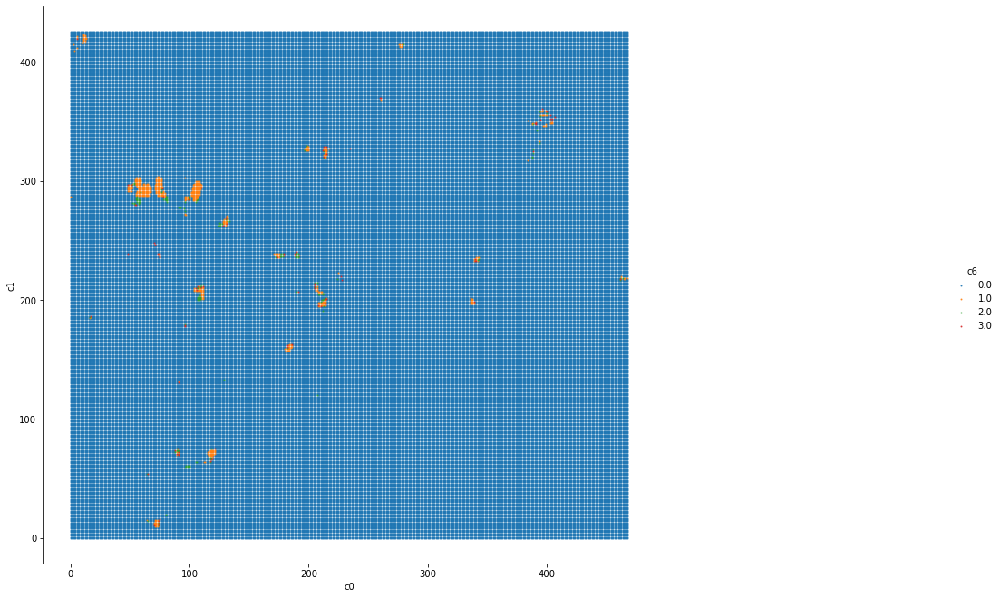

In [77]:
km = f.kmeans(clusters=4, fit_indexes=[2,3,4,5], # H,S,V, exgr
                plot_figure=True,
                xy_indexes=(0,1),scatter_size=1)

plt.gca().set_aspect('equal')
plt.gcf().set_size_inches(20,10) # ARGHHHHH

# Feature selection + generic k means

## Trying to use FSFC, i.e. github repo "Feature Selection For Clustering"
https://github.com/danilkolikov/fsfc
TODO: Find out more about the techniques used in his paper

In [45]:
from fsfc.generic import NormalizedCut
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [49]:
# from sklearn.datasets import make_blobs
# exampleX, exampleY = make_blobs(n_samples=100, n_features=6, centers = 4)
# print(exampleX.shape, exampleY.shape)

# nc = NormalizedCut(3)
# X_transform = nc.fit_transform(exampleX)
# print(nc.get_support())
# # print(type(X_transform), X_transform.shape)

# km1 = KMeans(init='k-means++', n_clusters=4, random_state = 42).fit(exampleX)
# print("Sil avg:", silhouette_score(exampleX, km1.labels_))

# km2 = KMeans(init='k-means++', n_clusters=4, random_state = 42).fit(X_transform)
# print("Sil avg:", silhouette_score(exampleX, km2.labels_)) # oops haha its even lower

okay the NormalizedCut was taking too long to run on the 350x350 data- might try again with a smaller 200x200 Frame2D?
## Trying a wrapper approach (forward selection based on silhouette score) instead of FSFC
If an added feature gives us the highest silhouette score, then we will use that feature

In [50]:
flat = pd.DataFrame(f.data_flatten())
print(flat.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 114921 entries, 0 to 114920
Data columns (total 15 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   0       114921 non-null  float64
 1   1       114921 non-null  float64
 2   2       114921 non-null  float64
 3   3       114921 non-null  float64
 4   4       114921 non-null  float64
 5   5       114921 non-null  float64
 6   6       114921 non-null  float64
 7   7       114921 non-null  float64
 8   8       114921 non-null  float64
 9   9       114921 non-null  float64
 10  10      114921 non-null  float64
 11  11      114921 non-null  float64
 12  12      114921 non-null  float64
 13  13      114921 non-null  float64
 14  14      114921 non-null  float64
dtypes: float64(15)
memory usage: 13.2 MB
None


In [66]:
flat[2]

0         0.237971
1         0.237257
2         0.237257
3         0.237381
4         0.237381
            ...   
114916    0.221171
114917    0.221374
114918    0.222450
114919    0.223667
114920    0.226331
Name: 2, Length: 114921, dtype: float64

In [54]:
num_clust = 5
def forwardselection(data, data_keep, columnlist):
    feature_sil_score = {}

    for feature in columnlist:

        print(feature, ":")
        data_keep = pd.concat([data_keep, data[feature]], axis = 1)

        km = KMeans(n_clusters = num_clust, random_state=42).fit(data_keep)
        labels = km.labels_
        n_clusters_ = len(set(labels))

        # we want more than just one big cluster
        if n_clusters_ > 1:
            silhouette_avg = silhouette_score(data_keep, labels)
            print("The average silhouette_score is :", silhouette_avg)
            feature_sil_score[feature] = silhouette_avg

    feature_names = []
    for feature, score in sorted(feature_sil_score.items(), key = lambda kv:(kv[1], kv[0]), reverse = True):
        print(feature,":", score)
        feature_names.append(feature) 
    return feature_names

In [68]:
importance2 = forwardselection(flat, flat[[0,1]], [col for col in range(2,14)]) # keep x and y; choose the rest of the featuress to add

2 :
The average silhouette_score is : 0.3892814508959765
3 :
The average silhouette_score is : 0.38928269054552284
4 :
The average silhouette_score is : 0.38927963047777686
5 :
The average silhouette_score is : 0.38925835321788443
6 :
The average silhouette_score is : 0.521684145935078
7 :
The average silhouette_score is : 0.514323667790354
8 :
The average silhouette_score is : 0.48499987625807395
9 :
The average silhouette_score is : 0.47806764203717395
10 :
The average silhouette_score is : 0.46720490288498145
11 :
The average silhouette_score is : 0.46593606160608
12 :
The average silhouette_score is : 0.4660466556411281
13 :
The average silhouette_score is : 0.46604389927625534
6 : 0.521684145935078
7 : 0.514323667790354
8 : 0.48499987625807395
9 : 0.47806764203717395
10 : 0.46720490288498145
12 : 0.4660466556411281
13 : 0.46604389927625534
11 : 0.46593606160608
3 : 0.38928269054552284
2 : 0.3892814508959765
4 : 0.38927963047777686
5 : 0.38925835321788443


In [69]:
print(importance2)

[6, 7, 8, 9, 10, 12, 13, 11, 3, 2, 4, 5]


# KDTree


In [82]:
f.data.shape

(427, 469, 6)

In [81]:
f.data_flatten().shape

(200263, 6)

In [83]:
from scipy.spatial import KDTree
tree = KDTree(f.data_flatten())

In [87]:
tree.tree

In [28]:
f.data_flatten().shape

(122500, 6)

# las to np 

In [9]:
!pip install laspy
import numpy as np
from laspy.file import File # https://pythonhosted.org/laspy/file.html

In [27]:
f = File('/Users/phoebezhouhuixin/Downloads/cloud_X.las', mode='r')

In [46]:
for spec in f.point_format:
    print(spec.name)

X
Y
Z
intensity
flag_byte
raw_classification
scan_angle_rank
user_data
pt_src_id
red
green
blue


In [28]:
f.points

array([(( 946563, 290055, -81788, 65535, 9, 0, 0, 0, 0, 42496, 43520, 42752),),
       (( 945445, 288728, -81722, 65535, 9, 0, 0, 0, 0, 41728, 42240, 41984),),
       (( 944941, 287582, -81641, 65535, 9, 0, 0, 0, 0, 38400, 38656, 38144),),
       ...,
       ((1120372, -68523, -77452, 65535, 9, 0, 0, 0, 0, 23296, 31488, 14592),),
       ((1135987,  10409, -80059, 65535, 9, 0, 0, 0, 0, 38656, 43520, 42496),),
       ((1137969,   3300, -80136, 65535, 9, 0, 0, 0, 0, 37376, 37888, 37632),)],
      dtype=[('point', [('X', '<i4'), ('Y', '<i4'), ('Z', '<i4'), ('intensity', '<u2'), ('flag_byte', 'u1'), ('raw_classification', 'u1'), ('scan_angle_rank', 'i1'), ('user_data', 'u1'), ('pt_src_id', '<u2'), ('red', '<u2'), ('green', '<u2'), ('blue', '<u2')])])

In [33]:
print(f.__len__())
print(f.X.shape)

3661266
(3661266,)
(3661266,)


In [53]:
xyzrgb = np.concatenate((np.expand_dims(f.X,1), np.expand_dims(f.Y,1), np.expand_dims(f.Z,1), np.expand_dims(f.red,1), np.expand_dims(f.green,1), np.expand_dims(f.blue,1)), axis = 1)

In [54]:
xyzrgb.shape

(3661266, 6)